In [47]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
import os
import scipy.stats
import networkx as nx
from sklearn import metrics
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import radius_neighbors_graph
import matplotlib.patches as mpatches
import sklearn.neighbors
from scipy.spatial import distance
from skimage.filters import unsharp_mask
from skimage.color import rgb2gray
import skimage
from Bio import SeqIO
from Bio.KEGG import REST
from Bio.KEGG.KGML import KGML_parser
import io



In [2]:
imDir = "/nfs/turbo/umms-indikar/shared/projects/spatial_transcriptomics/data/images/lowres/"


lowres = {}

for f in os.listdir(imDir):
    if f.endswith("png"):
        fullpath = f"{imDir}{f}"
        img = skimage.io.imread(fullpath, as_gray=True)
        key = f.replace(".png", "")
        print(key, img.shape)
        lowres[key] = img

scalefactors = {
    'ND' : 0.050684236,
    'HFD8' : 0.051089484,
    'HFD14' : 0.04912436
}

print('done')

HFD14 (2000, 1628)
ND (2000, 1681)
HFD8 (2000, 1692)
done


In [3]:
fPath = "/nfs/turbo/umms-indikar/shared/projects/spatial_transcriptomics/data/LR/LewisLabUSCS/Mouse/Mouse-2020-Baccin-LR-pairs.xlsx"

lr = pd.read_excel(fPath)
print(lr.shape)

lr['ligand'] = lr['Ligand.Mouse'].str.upper()
lr['receptor'] = lr['Receptor.Mouse'].str.upper()
lr.head()

(2000, 8)


,Pair.Name,Ligand.Mouse,Receptor.Mouse,Source,ManualAnnotation,Ligand.CC,Ligand.GO,Reference (PMID / KEGG),ligand,receptor
0,A2m-Lrp1,A2m,Lrp1,Ramilowski,Correct,Secreted,Other,"1702392,10652313, 12194978",A2M,LRP1
1,Adgre5-Cd55,Adgre5,Cd55,Baccin,Correct,Membrane,Other,23447688,ADGRE5,CD55
2,Adipoq-Adipor1,Adipoq,Adipor1,Ramilowski,Correct,Secreted,Other,12802337,ADIPOQ,ADIPOR1
3,Adipoq-Adipor2,Adipoq,Adipor2,Ramilowski,Correct,Secreted,Other,"12802337, 12802330",ADIPOQ,ADIPOR2
4,Adm-Calcrl&Ramp2,Adm,Calcrl&Ramp2,Baccin,Correct,Secreted,Other,10342881,ADM,CALCRL&RAMP2


In [4]:
cardOutDir = "/nfs/turbo/umms-indikar/shared/projects/spatial_transcriptomics/data/CARDOuputs/"

dfList = []

for f in os.listdir(cardOutDir):
    if 'macrophage' in f:
        fullPath = f"{cardOutDir}{f}"
        key = f.split("_")[0]
        df = pd.read_csv(fullPath)
        df = df.rename(columns={'Unnamed: 0' : 'spotId'})
        df['key'] = key
        dfList.append(df)

df = pd.concat(dfList, ignore_index=True)
print(f"{df.shape=}")
print(df['key'].value_counts())
print()
df.head()

df.shape=(14836, 13)
HFD8     6782
ND       4068
HFD14    3986
Name: key, dtype: int64



,spotId,Dendritic cells,Mac4,Stromal cells,NK cells,Mac2,Monocytes,T cells,Mac5,Mac3,Mac1,B cells,key
0,AAACAAGTATCTCCCA.1,0.087213,0.113186,0.270488,0.096431,0.057255,0.083130,0.047384,0.163491,0.049659,0.006606,0.025157,HFD8
1,AAACACCAATAACTGC.1,0.159247,0.129071,0.105884,0.002606,0.084753,0.088446,0.016601,0.302068,0.046115,0.038813,0.026395,HFD8
2,AAACAGCTTTCAGAAG.1,0.042437,0.128286,0.329050,0.064440,0.050805,0.049080,0.052493,0.100578,0.065773,0.025274,0.091783,HFD8
3,AAACAGGGTCTATATT.1,0.038153,0.094966,0.294255,0.055503,0.061959,0.060107,0.048176,0.127678,0.099188,0.040547,0.079468,HFD8
4,AAACAGTGTTCCTGGG.1,0.000020,0.256841,0.323585,0.003329,0.015668,0.010229,0.002518,0.222850,0.000587,0.000737,0.163636,HFD8


In [5]:
sptDir =  "/nfs/turbo/umms-indikar/shared/projects/spatial_transcriptomics/data/CARDInputs/"

spt = {}

for f in os.listdir(sptDir):
    if "spt" in f and "macrophage" in f:
        print(f)
        fullPath = f"{sptDir}{f}"
        key = f.split("_")[0]
        sdf = pd.read_csv(fullPath)
        sdf = sdf.rename(columns={'Unnamed: 0' : 'gene'})
        sdf = sdf.set_index('gene')
        sdf = sdf.T
        sdf.index = sdf.index.str.replace("-", ".")
        spt[key] = sdf
    
print('done')

HFD8_macrophage_spt.csv
HFD14_macrophage_spt.csv
ND_macrophage_spt.csv
done


In [6]:
coordDir = "/nfs/turbo/umms-indikar/shared/projects/spatial_transcriptomics/data/CARDInputs/"

dfList = []

for f in os.listdir(coordDir):
    if "coord" in f:
        fullPath = f"{coordDir}{f}"
        key = f.split("_")[0]
        cdf = pd.read_csv(fullPath)
        cdf = cdf.rename(columns={'Unnamed: 0' : 'spotId'})
        cdf['key'] = key
        dfList.append(cdf)

cdf = pd.concat(dfList, ignore_index=True)
print(f"{cdf.shape=}")
print(cdf['key'].value_counts())
print()
cdf.head()

cdf.shape=(14848, 4)
HFD8     6788
ND       4072
HFD14    3988
Name: key, dtype: int64



,spotId,x,y,key
0,AAACATTTCCCGGATT.1,1139.783401,1365.804581,HFD14
1,AAACCGGGTAGGTACC.1,468.056902,1045.415505,HFD14
2,AAACCGTTCGTCCAGG.1,604.524374,1214.452428,HFD14
3,AAACCTAAGCAGCCGG.1,1003.708924,1433.743571,HFD14
4,AAACCTCATGAAGTTG.1,380.369919,960.970730,HFD14


In [7]:
"""Merge CARD predictions with spatial coordinates"""
df = pd.merge(cdf, df,
              how='left', 
              left_on=['spotId', 'key'],
              right_on=['spotId', 'key'])

df = df.fillna(0)
df = df.drop_duplicates() # very important!
print(df['key'].value_counts())
df.head()

HFD8     3394
ND       2036
HFD14    1994
Name: key, dtype: int64


,spotId,x,y,key,Dendritic cells,Mac4,Stromal cells,NK cells,Mac2,Monocytes,T cells,Mac5,Mac3,Mac1,B cells
0,AAACATTTCCCGGATT.1,1139.783401,1365.804581,HFD14,3.468007e-02,0.007548,0.409201,0.170860,0.004757,0.041542,0.055275,0.219997,0.010912,0.004188,0.041040
2,AAACCGGGTAGGTACC.1,468.056902,1045.415505,HFD14,1.280364e-03,0.088368,0.187514,0.019633,0.028867,0.129969,0.040070,0.450618,0.008903,0.013757,0.031021
4,AAACCGTTCGTCCAGG.1,604.524374,1214.452428,HFD14,3.752028e-04,0.004256,0.283055,0.187004,0.021560,0.108340,0.044845,0.310869,0.003200,0.004016,0.032480
6,AAACCTAAGCAGCCGG.1,1003.708924,1433.743571,HFD14,1.198581e-07,0.009084,0.239973,0.043516,0.004948,0.057287,0.052469,0.558332,0.000064,0.023214,0.011113
8,AAACCTCATGAAGTTG.1,380.369919,960.970730,HFD14,1.377525e-02,0.029749,0.216199,0.122802,0.053188,0.158933,0.041466,0.234411,0.043126,0.037127,0.049224


Text(0.5, 1.05, 'N = 400')

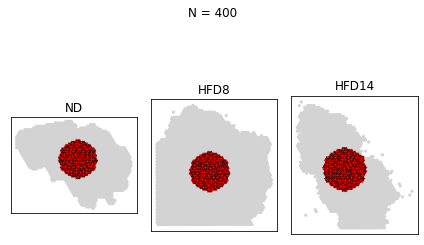

In [8]:
metric = 'minkowski'

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

keys = ['ND', 'HFD8', 'HFD14']
graph = {}
meta = {}

n = 400

def closest_node(node, nodes):
    closest_index = distance.cdist([node], nodes, metric=metric).argmin()
    return closest_index

for i, key in enumerate(keys):
    kdf = df[df['key'] == key].reset_index(drop=True)
    
    # get the center node index
    meanX = kdf['x'].mean()
    meanY = kdf['y'].mean()
    
    nodes = kdf[['x', 'y']]
    
    centerInd = closest_node([meanX, meanY], nodes)
    
    # get the n points around that node
    nbrs = NearestNeighbors(n_neighbors=n,  
                            metric=metric, 
                            algorithm='ball_tree').fit(nodes)
    distances, indices = nbrs.kneighbors(nodes)
    
    # create the subgraph
    windowIndices = indices[centerInd]
    mask = kdf.index.isin(windowIndices)
    
    center = kdf[mask].reset_index(drop=True)
    dists = sklearn.metrics.pairwise_distances(center[['x', 'y']], metric=metric)
    
    X = dists
    # X = np.where(dists < 65, 1, 0)
    # np.fill_diagonal(X, 0) # no self loops
    
    # create the graph
    nodeMapper = dict(zip(center.index, center['spotId']))
    G = nx.from_numpy_array(X)
    G = nx.relabel_nodes(G, nodeMapper)
    
    # set positions
    pos = {}
    for idx, row in center.iterrows():
        pos[row['spotId']] = np.array(row[['x', 'y']])
    
    G.pos = pos
    
    graph[key] = G
    meta[key] = center
            
    axs[i].scatter(kdf[mask]['x'].to_list(), 
                   kdf[mask]['y'].to_list(), 
                   c='r',
                   ec='k', 
                   lw=0.5,
                   s=10)
    axs[i].scatter(kdf[~mask]['x'].to_list(), 
                   kdf[~mask]['y'].to_list(), 
                   c='lightgrey',
                   ec='None', 
                   lw=0.5,
                   s=10)
    
    axs[i].invert_yaxis()
    axs[i].set_title(key)
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    axs[i].set_aspect('equal')
    
    
plt.tight_layout()
plt.suptitle(f"N = {n}", y=1.05)

Text(0.5, 1.05, 'Radius = 25')

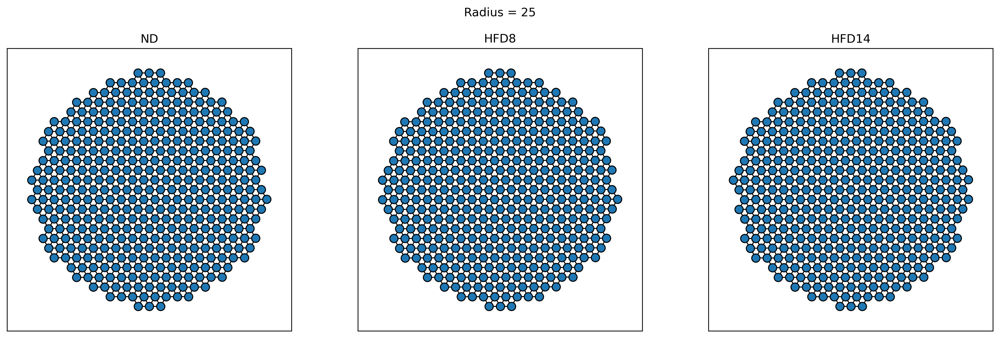

In [9]:
""" A nearest neighbors """

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

radius = 25

for i, key in enumerate(keys):
    
    G = graph[key]
    mf = meta[key]
    # G.remove_edges_from(nx.selfloop_edges(G))
    
    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=70,
                           edgecolors='k',
                           linewidths=1,
                           ax=axs[i])
    
    edgelist = [(u,v) for u,v,e in G.edges(data=True) if e['weight'] < radius]
    
    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           edgelist=edgelist,
                           ax=axs[i])
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
    
plt.tight_layout()
plt.suptitle(f"Radius = {radius}", y=1.05)

==== ND ====
	Density: 0.0009
	Fielder Num: 0.0000
	Number of nodes in largest cc: 29.0000 (0.0725)
==== HFD8 ====
	Density: 0.0189
	Fielder Num: 0.0000
	Number of nodes in largest cc: 321.0000 (0.8025)
==== HFD14 ====
	Density: 0.0369
	Fielder Num: 0.0000
	Number of nodes in largest cc: 380.0000 (0.9500)


Text(0.5, 1.05, 'Mac5 Radius = 45, Hmean T = 0.1')

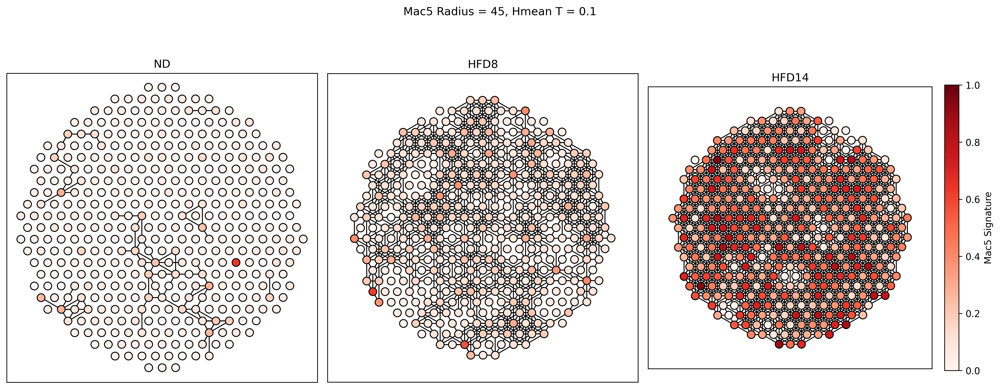

In [10]:
""" A nearest neighbors """

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 6

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

radius = 45
cmap = 'Reds'
t = 0.1
colorby = 'Mac5' 


def hmeanBool(x1, x2, t):
    if scipy.stats.hmean([x1, x2]) > t:
        return True
    else:
        return False

for i, key in enumerate(keys):
    
    G = graph[key]
    mf = meta[key]
    
    node_attr = mf.set_index('spotId').to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    colors = list(nx.get_node_attributes(G, colorby).values())
    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=70,
                           node_color=colors,
                           cmap=cmap,
                           vmin=0,
                           vmax=1,
                           edgecolors='k',
                           linewidths=1,
                           ax=axs[i])
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u][colorby]
            x2 = G.nodes[v][colorby]
            
            if hmeanBool(x1, x2, t):
                edgelist.append((u, v))

    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=1,
                           edgelist=edgelist,
                           ax=axs[i])     
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
   
     # add colorbar
    if i == 2:
        norm = plt.Normalize(0,1)
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        plt.colorbar(sm, 
                     ax=axs[i], 
                     fraction=0.046, 
                     pad=0.04, 
                     label=f'{colorby} Signature')
        
    """ Evaluate the subgraph """
    H = nx.Graph()
    H.add_nodes_from(G.nodes())
    H.add_edges_from(edgelist)
    
    # largest connected component
    components = sorted(nx.connected_components(H), key=len, reverse=True)
    cc = G.subgraph(components[0])
    
    print(f"==== {key} ====")
    print(f"\tDensity: {nx.density(H):.4f}")
    print(f"\tFielder Num: {nx.algebraic_connectivity(H, normalized=True):.4f}")
    nH = nx.number_of_nodes(cc)
    nG = nx.number_of_nodes(G)
    print(f"\tNumber of nodes in largest cc: {nH:.4f} ({nH/nG:.4f})")
    
plt.tight_layout()
plt.suptitle(f"{colorby} Radius = {radius}, Hmean T = {t}", y=1.05)

==== ND ====
	Density: 0.0012
	Fielder Num: 0.0000
	Number of nodes in largest cc: 47.0000 (0.1175)
==== HFD8 ====
	Density: 0.0040
	Fielder Num: 0.0000
	Number of nodes in largest cc: 221.0000 (0.5525)
==== HFD14 ====
	Density: 0.0125
	Fielder Num: 0.0000
	Number of nodes in largest cc: 347.0000 (0.8675)


Text(0.5, 1.05, 'Stromal cells vs. Mac5 radius = 45, Hmean T = 0.3')

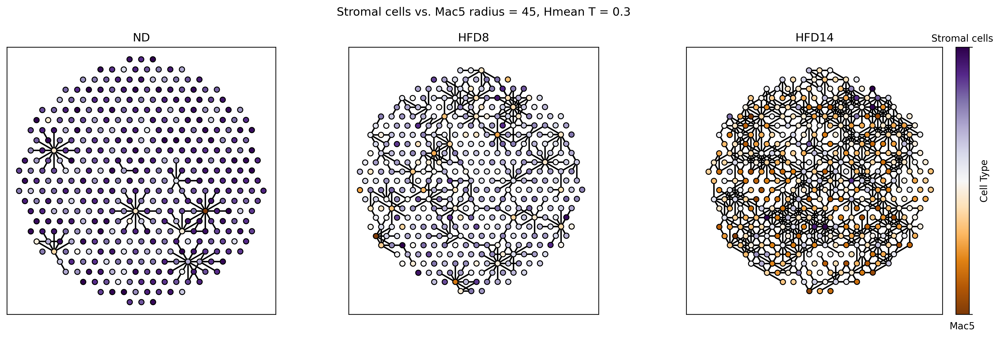

In [11]:
""" A nearest neighbors """

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

radius = 45
cmap = 'PuOr'
t = 0.3
primary = 'Stromal cells'
secondary = 'Mac5'

for i, key in enumerate(keys):
    
    G = graph[key]
    mf = meta[key]
    
    node_attr = mf.set_index('spotId').to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    pX = mf[primary]
    sX = mf[secondary] * -1
    
    colors = pX + sX
    
    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=30,
                           node_color=colors,
                           cmap=cmap,
                           # vmin=-1,
                           # vmax=1,
                           edgecolors='k',
                           linewidths=1,
                           ax=axs[i])
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u][primary]
            x2 = G.nodes[v][secondary]
            
            if hmeanBool(x1, x2, t):
                edgelist.append((u, v))

    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=1.5,
                           edgelist=edgelist,
                           ax=axs[i])     
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
   
    # add colorbar
    if i == 2:
        norm = plt.Normalize(np.min(colors),np.max(colors))
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar  = plt.colorbar(sm, 
                             ax=axs[i], 
                             fraction=0.046, 
                             pad=0.04, 
                             ticks=[np.min(colors), np.max(colors)],
                             label=f'Cell Type')

        cbar.ax.set_yticklabels([])
        cbar.ax.set_title(primary, fontsize=10)
        cbar.ax.set_xlabel(secondary, fontsize=10)
        
    """ Evaluate the subgraph """
    H = nx.Graph()
    H.add_nodes_from(G.nodes())
    H.add_edges_from(edgelist)
    
    # largest connected component
    components = sorted(nx.connected_components(H), key=len, reverse=True)
    cc = G.subgraph(components[0])
    
    print(f"==== {key} ====")
    print(f"\tDensity: {nx.density(H):.4f}")
    print(f"\tFielder Num: {nx.algebraic_connectivity(H, normalized=True):.4f}")
    nH = nx.number_of_nodes(cc)
    nG = nx.number_of_nodes(G)
    print(f"\tNumber of nodes in largest cc: {nH:.4f} ({nH/nG:.4f})")
    
plt.tight_layout()
plt.suptitle(f"{primary} vs. {secondary} radius = {radius}, Hmean T = {t}", y=1.05)

==== ND ====
	Density: 0.0002
	Fielder Num: 0.0000
	Number of nodes in largest cc: 4.0000 (0.0100)
==== HFD8 ====
	Density: 0.0010
	Fielder Num: 0.0000
	Number of nodes in largest cc: 12.0000 (0.0300)
==== HFD14 ====
	Density: 0.0034
	Fielder Num: 0.0000
	Number of nodes in largest cc: 43.0000 (0.1075)


Text(0.5, 1.05, 'Cd36 vs. Col1a1 radius = 25, Hmean T = 0.05')

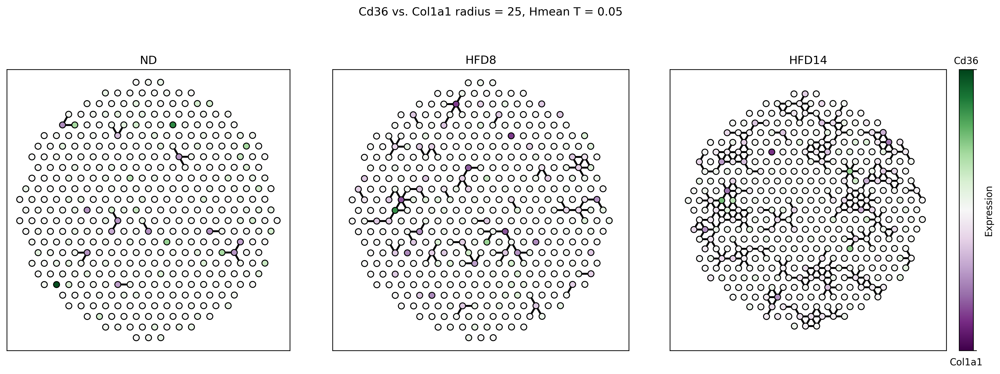

In [12]:
""" A nearest neighbors """

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

radius = 25
cmap = 'PRGn'
t = 0.05
g1 = 'Cd36'
g2 = 'Col1a1'

for i, key in enumerate(keys):
    
    G = graph[key]
    mf = meta[key]
    sdf = spt[key]
    
    # filter the window
    sdf = sdf[sdf.index.isin(mf['spotId'])]
    sdf = sdf.reindex(mf['spotId'])
    
    node_attr = sdf[[g1.upper(), g2.upper()]].to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    # binary expression patterns
    x = sdf[g1.upper()]
    y = sdf[g2.upper()]
    
    x = x / (x.max() + 1) # add one in case the gene isn't expressed
    y = (y / (y.max() + 1)) * -1
    
    colors = x + y
    
    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=40,
                           node_color=colors,
                           cmap=cmap,
                           vmin=-1,
                           vmax=1,
                           edgecolors='k',
                           linewidths=1,
                           ax=axs[i])
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u][g1.upper()]
            x2 = G.nodes[v][g2.upper()]
            
            if hmeanBool(x1, x2, t):
                edgelist.append((u, v))
                

    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=2,
                           edgelist=edgelist,
                           ax=axs[i])     
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
   
    # add colorbar
    if i == 2:
        norm = plt.Normalize(np.min(colors),np.max(colors))
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar  = plt.colorbar(sm, 
                             ax=axs[i], 
                             fraction=0.046, 
                             pad=0.04, 
                             ticks=[np.min(colors), np.max(colors)],
                             label=f'Expression')

        cbar.ax.set_yticklabels([])
        cbar.ax.set_title(g1.lower().capitalize(), fontsize=10)
        cbar.ax.set_xlabel(g2.lower().capitalize(), fontsize=10)
        
    """ Evaluate the subgraph """
    H = nx.Graph()
    H.add_nodes_from(G.nodes())
    H.add_edges_from(edgelist)
    
    # largest connected component
    components = sorted(nx.connected_components(H), key=len, reverse=True)
    cc = G.subgraph(components[0])
    
    print(f"==== {key} ====")
    print(f"\tDensity: {nx.density(H):.4f}")
    print(f"\tFielder Num: {nx.algebraic_connectivity(H, normalized=True):.4f}")
    nH = nx.number_of_nodes(cc)
    nG = nx.number_of_nodes(G)
    print(f"\tNumber of nodes in largest cc: {nH:.4f} ({nH/nG:.4f})")
    
plt.tight_layout()
plt.suptitle(f"{primary} vs. {secondary} radius = {radius}, Hmean T = {t}", y=1.05)
    
plt.tight_layout()
plt.suptitle(f"{g1.lower().capitalize()} vs. {g2.lower().capitalize()} radius = {radius}, Hmean T = {t}", y=1.05)

Alzheimer disease
number of lr pairs found in mmu05010 180
==== ND ====
	Density: 0.0015
	Fielder Num: 0.0000
	Number of nodes in largest cc: 23.0000 (0.0575)
==== HFD8 ====
	Density: 0.0028
	Fielder Num: 0.0000
	Number of nodes in largest cc: 43.0000 (0.1075)
==== HFD14 ====
	Density: 0.0041
	Fielder Num: 0.0000
	Number of nodes in largest cc: 126.0000 (0.3150)


Text(0.5, 1.05, 'KEGG: Alzheimer disease LR Pairs radius = 25')

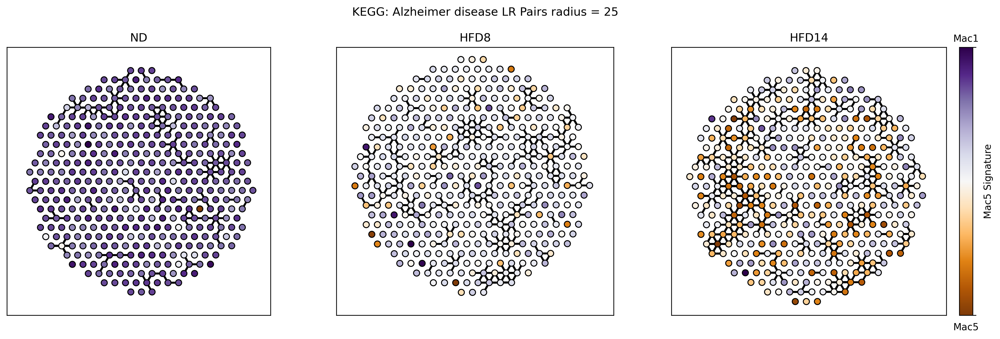

In [13]:
def parseKEGG(pathId):
    genes = []
    results = REST.kegg_get(pathId).read()
    current_section = None
    for line in results.rstrip().split("\n"):
        section = line[:12].strip()  # section names are within 12 columns
        if not section == "":
            current_section = section

        if current_section == "GENE":
            linesplit = line[12:].split("; ")
            gene_identifiers = linesplit[0]
            gene_id, gene_symbol = gene_identifiers.split()
    
            if not gene_symbol in genes:
                genes.append(gene_symbol)
    return genes


def getPathname(pathId):
    """A function to return the legg pathname"""
    result = REST.kegg_list(pathId).read()
    return result.split("\t")[1].split("-")[0].strip()


pathId = 'mmu05010'
pathname = getPathname(pathId)
print(pathname)
radius = 25
cmap = 'PuOr'
primary = 'Mac1'
secondary = 'Mac5'

genes = parseKEGG(pathId)
genes = [x.upper() for x in genes]

mask = ((lr['ligand'].isin(genes)) | (lr['receptor'].isin(genes)))
ldf = lr[mask].reset_index()
print(f"number of lr pairs found in {pathId} {ldf.shape[0]}")


plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

for i, key in enumerate(keys):
    G = graph[key]
    mf = meta[key]
    sdf = spt[key]
    
    # filter the window
    sdf = sdf[sdf.index.isin(mf['spotId'])]
    sdf = sdf.reindex(mf['spotId'])
    
    allLR = list(set(ldf['ligand'].to_list() + ldf['receptor'].to_list()))
    
    expGenes = [x for x in allLR if x in sdf.columns]
    
    node_attr = sdf[expGenes].to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    pX = mf[primary]
    sX = mf[secondary] * -1
    
    colors = pX + sX
    
    nx.draw_networkx_nodes(G,
                            pos=G.pos,
                            node_size=40,
                            node_color=colors,
                            cmap=cmap,
                            edgecolors='k',
                            linewidths=1,
                            ax=axs[i])
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u]
            x2 = G.nodes[v]
            
            for idx, row in ldf.iterrows():
                queryL = row['ligand']
                queryR = row['receptor']
                
                if queryL in expGenes and queryR in expGenes:
                
                    if (x1[queryL] > 0) & (x2[queryR] > 0):
                        edgelist.append((u, v))
                    if (x1[queryR] > 0) & (x2[queryL] > 0):
                        edgelist.append((u, v))
                
    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=2,
                           edgelist=edgelist,
                           ax=axs[i])     
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
    
     
    # add colorbar
    if i == 2:
        norm = plt.Normalize(np.min(colors),np.max(colors))
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar  = plt.colorbar(sm, 
                             ax=axs[i], 
                             fraction=0.046, 
                             pad=0.04, 
                             ticks=[np.min(colors), np.max(colors)],
                             label=f'{colorby} Signature')

        cbar.ax.set_yticklabels([])
        cbar.ax.set_title(primary, fontsize=10)
        cbar.ax.set_xlabel(secondary, fontsize=10)
        
    """ Evaluate the subgraph """
    H = nx.Graph()
    H.add_nodes_from(G.nodes())
    H.add_edges_from(edgelist)
    
    # largest connected component
    components = sorted(nx.connected_components(H), key=len, reverse=True)
    cc = G.subgraph(components[0])
    
    print(f"==== {key} ====")
    print(f"\tDensity: {nx.density(H):.4f}")
    print(f"\tFielder Num: {nx.algebraic_connectivity(H, normalized=True):.4f}")
    nH = nx.number_of_nodes(cc)
    nG = nx.number_of_nodes(G)
    print(f"\tNumber of nodes in largest cc: {nH:.4f} ({nH/nG:.4f})")
    
plt.tight_layout()    
plt.suptitle(f"KEGG: {pathname} LR Pairs radius = {radius}", y=1.05)

Alzheimer disease
number of lr pairs found in mmu05010 180
==== ND ====
	Density of H: 0.0015
	Clustering coef of H: 0.0252
	Efficiency of H: 0.0276
	Fielder Num of H: 0.0000
	Connectivity of H: 0.0
	Number of nodes in largest cc: 23.0000 (0.0575)
==== HFD8 ====
	Density of H: 0.0028
	Clustering coef of H: 0.0757
	Efficiency of H: 0.0808
	Fielder Num of H: 0.0000
	Connectivity of H: 0.0
	Number of nodes in largest cc: 43.0000 (0.1075)
==== HFD14 ====
	Density of H: 0.0041
	Clustering coef of H: 0.1109
	Efficiency of H: 0.1246
	Fielder Num of H: 0.0000
	Connectivity of H: 0.0
	Number of nodes in largest cc: 126.0000 (0.3150)


Text(0.5, 1.05, 'KEGG: Alzheimer disease LR Pairs radius = 25')

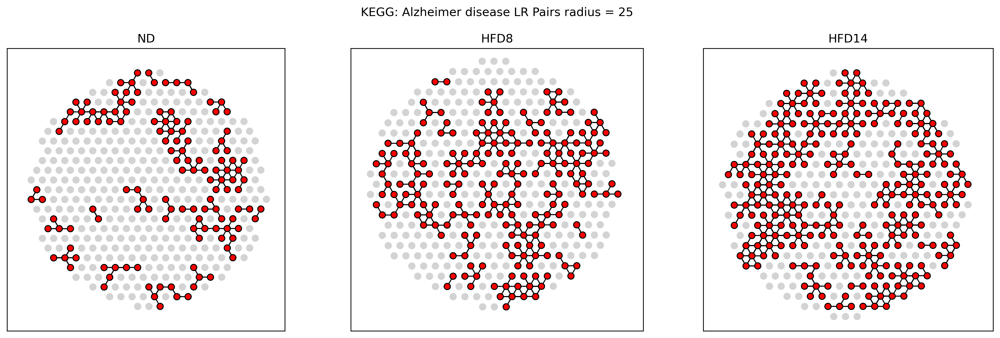

In [14]:
def parseKEGG(pathId):
    genes = []
    results = REST.kegg_get(pathId).read()
    current_section = None
    for line in results.rstrip().split("\n"):
        section = line[:12].strip()  # section names are within 12 columns
        if not section == "":
            current_section = section

        if current_section == "GENE":
            linesplit = line[12:].split("; ")
            gene_identifiers = linesplit[0]
            gene_id, gene_symbol = gene_identifiers.split()
    
            if not gene_symbol in genes:
                genes.append(gene_symbol)
    return genes


def getPathname(pathId):
    """A function to return the legg pathname"""
    result = REST.kegg_list(pathId).read()
    return result.split("\t")[1].split("-")[0].strip()


pathId = 'mmu05010'
pathname = getPathname(pathId)
print(pathname)
radius = 25

genes = parseKEGG(pathId)
genes = [x.upper() for x in genes]

mask = ((lr['ligand'].isin(genes)) | (lr['receptor'].isin(genes)))
ldf = lr[mask].reset_index()
print(f"number of lr pairs found in {pathId} {ldf.shape[0]}")


plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

pway = {}

for i, key in enumerate(keys):
    G = graph[key]
    mf = meta[key]
    sdf = spt[key]
    
    # filter the window
    sdf = sdf[sdf.index.isin(mf['spotId'])]
    sdf = sdf.reindex(mf['spotId'])
    
    allLR = list(set(ldf['ligand'].to_list() + ldf['receptor'].to_list()))
    
    expGenes = [x for x in allLR if x in sdf.columns]
    
    node_attr = sdf[expGenes].to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u]
            x2 = G.nodes[v]
            
            for idx, row in ldf.iterrows():
                queryL = row['ligand']
                queryR = row['receptor']
                
                if queryL in expGenes and queryR in expGenes:
                    if (x1[queryL] > 0) & (x2[queryR] > 0):
                        edgelist.append((u, v))
                    if (x1[queryR] > 0) & (x2[queryL] > 0):
                        edgelist.append((u, v))
                
    colors = []
    connectedNodes = list(set(list(sum(edgelist, ()))))
    edgecolors = []
    for n in list(G.nodes()):
        if n in set(connectedNodes):
            colors.append("r")
            edgecolors.append("k")
        else:
            colors.append("lightgrey")
            edgecolors.append("lightgrey")
        
    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=40,
                           node_color=colors,
                           edgecolors=edgecolors,
                           linewidths=1,
                           ax=axs[i])
    
    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=1,
                           edgelist=edgelist,
                           ax=axs[i])   
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
        
    """ Evaluate the subgraph """
    H = nx.Graph()
    H.add_nodes_from(G.nodes())
    H.add_edges_from(edgelist)
    H.pos = G.pos
    
    pway[key] = H
    
    # largest connected component
    components = sorted(nx.connected_components(H), key=len, reverse=True)
    cc = G.subgraph(components[0])
    
    print(f"==== {key} ====")
    print(f"\tDensity of H: {nx.density(H):.4f}")
    print(f"\tClustering coef of H: {nx.average_clustering(H):.4f}")
    print(f"\tEfficiency of H: {nx.local_efficiency(H):.4f}")
    print(f"\tFielder Num of H: {nx.algebraic_connectivity(H, normalized=True):.4f}")
    print(f"\tConnectivity of H: {nx.node_connectivity(H):.1f}")
    nH = nx.number_of_nodes(cc)
    nG = nx.number_of_nodes(G)
    print(f"\tNumber of nodes in largest cc: {nH:.4f} ({nH/nG:.4f})")
    # print(f"\tSmall world coef of largest cc: {nx.sigma(cc):.4f}")
    
plt.tight_layout()    
plt.suptitle(f"KEGG: {pathname} LR Pairs radius = {radius}", y=1.05)

,spotId,key,degree_centrality,betweenness_centrality,closeness_centrality,harmonic_centrality
0,AAACGAGACGGTTGAT.1,ND,0.007519,0.000038,0.007519,3.0
1,AAACTGCTGGCTCCAA.1,ND,0.000000,0.000000,0.000000,0.0
2,AAATACCTATAAGCAT.1,ND,0.002506,0.000000,0.003342,1.5
3,AAATAGGGTGCTATTG.1,ND,0.000000,0.000000,0.000000,0.0
4,AAATCGTGTACCACAA.1,ND,0.000000,0.000000,0.000000,0.0


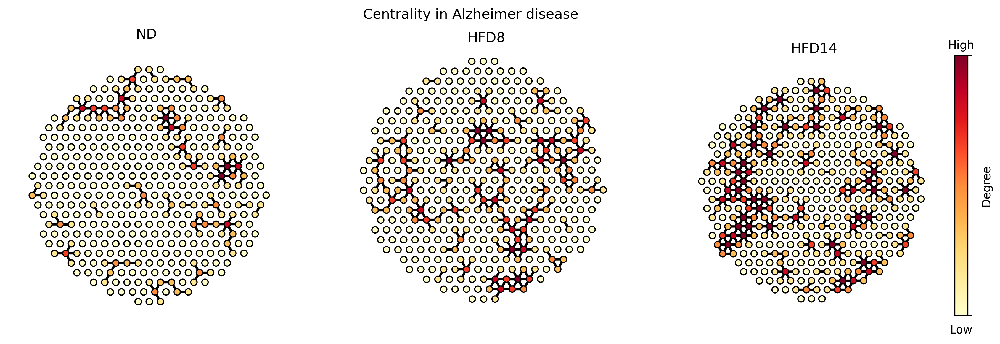

In [15]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

cmap = 'YlOrRd'

res = []

for i, key in enumerate(keys):
    
    H = pway[key]
    
    
    cf = pd.DataFrame({'spotId' : H.nodes()})
    cf['key'] = key
    cf['degree_centrality'] = cf['spotId'].map(nx.degree_centrality(H))
    cf['betweenness_centrality'] = cf['spotId'].map(nx.betweenness_centrality(H))
    cf['closeness_centrality'] = cf['spotId'].map(nx.closeness_centrality(H))
    cf['harmonic_centrality'] = cf['spotId'].map(nx.harmonic_centrality(H))
    
    res.append(cf)
    
    colors = cf['degree_centrality'].to_list()
    
    nx.draw(H, 
            pos=H.pos,
            node_size=30,
            edgecolors='k',
            node_color=colors,
            cmap=cmap,
            width=2,
            ax=axs[i])
    
    axs[i].set_title(key)
    axs[i].set_aspect('equal')
    axs[i].invert_yaxis()
    
    
         
    # add colorbar
    if i == 2:
        norm = plt.Normalize(np.min(colors),np.max(colors))
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar  = plt.colorbar(sm, 
                             ax=axs[i], 
                             fraction=0.046, 
                             pad=0.04, 
                             ticks=[np.min(colors), np.max(colors)],
                             label=f'Degree')

        cbar.ax.set_yticklabels([])
        cbar.ax.set_title("High", fontsize=10)
        cbar.ax.set_xlabel("Low", fontsize=10)

plt.suptitle(f"Centrality in {pathname}")

res = pd.concat(res, ignore_index=True)
res.head()

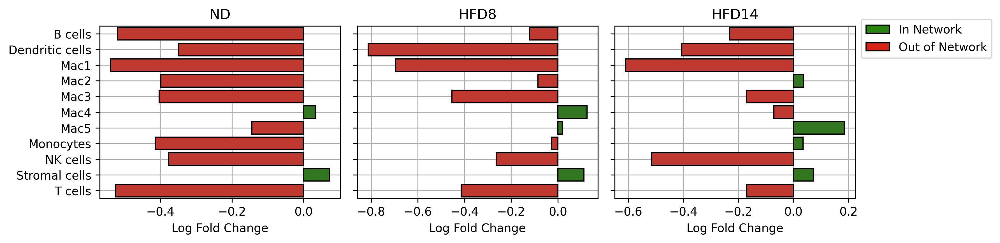

In [16]:
cTypes = ['Dendritic cells', 
          'Mac4', 
          'Stromal cells',
          'NK cells',
          'Mac2', 
          'Monocytes',
          'T cells',
          'Mac5',
          'Mac3', 
          'Mac1',
          'B cells']

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 12, 3


fig, axs = plt.subplots(1, 3, sharey=True)
axs = axs.ravel()

for i, key in enumerate(keys):
    mf = meta[key]
    sdf = spt[key]
    
    
    # centralities
    cf = res[res['key'] == key]
    mask = cf['degree_centrality'] > 0
    spotIds = cf[mask]['spotId'].to_list()
    otherIds = cf[~mask]['spotId'].to_list()
    
    # cellType analysis
    inGroup = mf[mf['spotId'].isin(spotIds)]
    outGroup = mf[mf['spotId'].isin(otherIds)]
    
    newRows = []
    
    for ctype in sorted(cTypes):
        meanGroup = inGroup[ctype].mean()
        meanOther = outGroup[ctype].mean()
        lfc = np.log2(meanGroup) - np.log2(meanOther)
        
        row = {
            'cellType' : ctype,
            'meanGroup' : meanGroup,
            'meanOther' : meanOther,
            "lfc" : lfc,
        }
        
        newRows.append(row)
    
    r = pd.DataFrame(newRows)
    r = r.sort_values(by='cellType')
    r['color'] = np.where(r['lfc'] > 0, 0, 1)
    
    # print(r)
    # break
    
    sns.barplot(data=r,
                y='cellType', 
                x='lfc',
                hue=r['color'].to_list(),
                palette=['#298510', '#d62418'],
                edgecolor='k',
                zorder=2,
                dodge=False,
                ax=axs[i])

    axs[i].legend_.remove()
    
    handles = [
        mpatches.Patch(color='#298510',
                       ec='k', 
                       label='In Network'),
        mpatches.Patch(color='#d62418',
                       ec='k', 
                       label='Out of Network'),
    ]
    
    
    if i == 2:
        axs[i].legend(handles=handles, bbox_to_anchor=(1, .78))
    
    
    axs[i].set_xlabel("")
    axs[i].set_xlabel("Log Fold Change")
        
    axs[i].set_ylabel("")
    axs[i].grid(True, zorder=1)
    axs[i].set_title(key)
    
    
plt.tight_layout()
    
    

Text(0.5, 0.98, 'Highly Connected Nodes in Alzheimer disease (D > 3)')

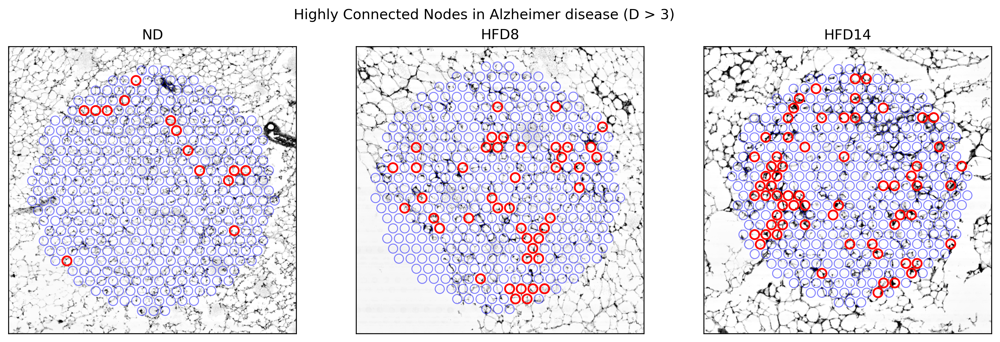

In [17]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 4.5

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

cmap = 'YlOrRd'
degreeT = 3
plotBox = 500

for i, key in enumerate(keys):
    
    H = pway[key]
    
    
    cf = pd.DataFrame({'spotId' : H.nodes()})
    cf['key'] = key
    cf['degree_centrality'] = cf['spotId'].map(nx.degree_centrality(H))
    cf['degree'] = cf['spotId'].map(nx.degree(H))
    cf['betweenness_centrality'] = cf['spotId'].map(nx.betweenness_centrality(H))
    cf['closeness_centrality'] = cf['spotId'].map(nx.closeness_centrality(H))
    cf['harmonic_centrality'] = cf['spotId'].map(nx.harmonic_centrality(H))
    
    colors = cf['degree_centrality'].to_list()
    
    mask = cf['degree'] > degreeT
    connectedNodes = cf[mask]['spotId'].to_list()
    disconnectedNodes = cf[~mask]['spotId'].to_list()
    
    nx.draw_networkx_nodes(H,
                           pos=H.pos,
                           node_size=60,
                           node_color='None',
                           nodelist=connectedNodes,
                           edgecolors='r',
                           linewidths=1.5,
                           ax=axs[i])
    
    nx.draw_networkx_nodes(H,
                       pos=H.pos,
                       node_size=60,
                       node_color='None',
                       nodelist=disconnectedNodes,
                       edgecolors='b',
                       alpha=0.5,
                       linewidths=0.8,
                       ax=axs[i])

    img = lowres[key]

    # unsharp masking for illumination correction
    img = unsharp_mask(img, 
                       radius=30, 
                       amount=0.6)
    
    axs[i].imshow(img, 
                  cmap='binary_r', 
                  zorder=0)
    
    kdf = df[df['key'] == key].reset_index(drop=True)
    
    # get the center node index
    xMid = kdf['x'].mean()
    yMid = kdf['y'].mean()
    
    xLb = int(xMid - (plotBox / 2))
    xUb = int(xMid + (plotBox / 2))
    
    yLb = int(yMid - (plotBox / 2))
    yUb = int(yMid + (plotBox / 2))

    axs[i].set_ylim([yUb, yLb])
    axs[i].set_xlim([xLb, xUb])    
    axs[i].set_title(key)
    axs[i].set_xticks([])
    axs[i].set_yticks([])

plt.suptitle(f"Highly Connected Nodes in {pathname} (D > {degreeT})")

# Crown-like structures

Text(0.5, 1.05, 'Trem2 vs. Itgax')

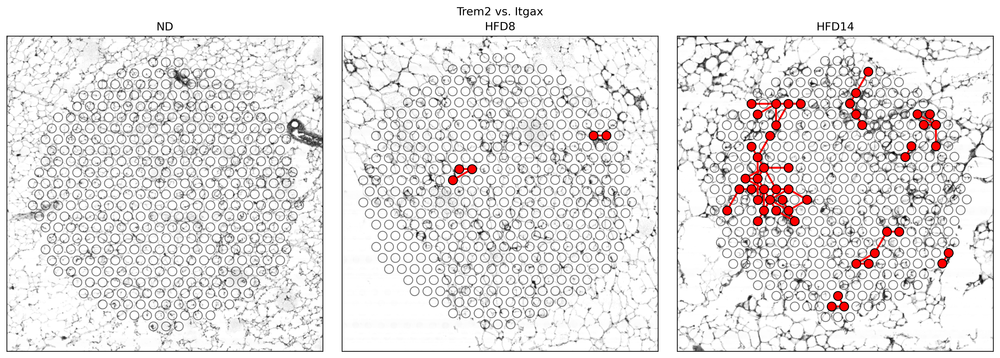

In [18]:
""" A nearest neighbors """

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 5

plotBox = 500

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

radius = 45
cmap = 'PRGn'
t = 0.005
g1 = 'Trem2'
g2 = 'Itgax'

for i, key in enumerate(keys):
    
    G = graph[key]
    mf = meta[key]
    sdf = spt[key]
    
    # # shift the positions    
    # for n in G.nodes():
    #     G.pos[n] = G.pos[n]*scalefactors[key] 

    # filter the window
    sdf = sdf[sdf.index.isin(mf['spotId'])]
    sdf = sdf.reindex(mf['spotId'])
    
    node_attr = sdf[[g1.upper(), g2.upper()]].to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u][g1.upper()]
            x2 = G.nodes[v][g2.upper()]
            
            if hmeanBool(x1, x2, t):
                edgelist.append((u, v))
                
    colors = []
    connectedNodes = list(set(list(sum(edgelist, ()))))
    
    disconnectedNodes = [x for x in G.nodes() if not x in connectedNodes]

    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=90,
                           node_color='r',
                           # alpha=0.5,
                           nodelist=connectedNodes,
                           edgecolors='k',
                           linewidths=1,
                           ax=axs[i])
    
    
    nx.draw_networkx_nodes(G,
                       pos=G.pos,
                       node_size=90,
                       node_color='None',
                       alpha=0.5,
                       nodelist=disconnectedNodes,
                       edgecolors='k',
                       linewidths=1,
                       ax=axs[i])
    
    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=2,
                           edge_color='r',
                           edgelist=edgelist,
                           ax=axs[i])   
    
    img = lowres[key]
    axs[i].imshow(img, 
                  cmap='binary_r', 
                  zorder=0)
    
    kdf = df[df['key'] == key].reset_index(drop=True)
    
    # get the center node index
    xMid = kdf['x'].mean()
    yMid = kdf['y'].mean()
    
    xLb = int(xMid - (plotBox / 2))
    xUb = int(xMid + (plotBox / 2))
    
    yLb = int(yMid - (plotBox / 2))
    yUb = int(yMid + (plotBox / 2))

    axs[i].set_ylim([yUb, yLb])
    axs[i].set_xlim([xLb, xUb])    
    axs[i].set_title(key)
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    
plt.tight_layout()
plt.suptitle(f"{g1} vs. {g2}",  y=1.05)

Text(0.5, 1.05, 'Trem2 vs. Cd68')

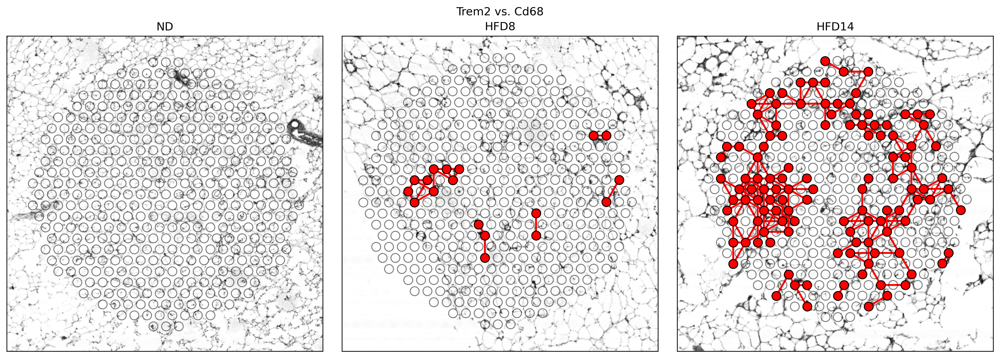

In [19]:
""" A nearest neighbors """

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 5

plotBox = 500

fig, axs = plt.subplots(1, 3)
axs = axs.ravel()

radius = 45
cmap = 'PRGn'
t = 0.005
g1 = 'Trem2'
g2 = 'Cd68'

for i, key in enumerate(keys):
    
    G = graph[key]
    mf = meta[key]
    sdf = spt[key]
    
    # # shift the positions    
    # for n in G.nodes():
    #     G.pos[n] = G.pos[n]*scalefactors[key] 

    # filter the window
    sdf = sdf[sdf.index.isin(mf['spotId'])]
    sdf = sdf.reindex(mf['spotId'])
    
    node_attr = sdf[[g1.upper(), g2.upper()]].to_dict('index')
    nx.set_node_attributes(G, node_attr)
    
    edgelist = []
    for u,v,e in G.edges(data=True):
        if e['weight'] < radius:
            
            x1 = G.nodes[u][g1.upper()]
            x2 = G.nodes[v][g2.upper()]
            
            if hmeanBool(x1, x2, t):
                edgelist.append((u, v))
                
    colors = []
    connectedNodes = list(set(list(sum(edgelist, ()))))
    
    disconnectedNodes = [x for x in G.nodes() if not x in connectedNodes]

    nx.draw_networkx_nodes(G,
                           pos=G.pos,
                           node_size=90,
                           node_color='r',
                           # alpha=0.5,
                           nodelist=connectedNodes,
                           edgecolors='k',
                           linewidths=1,
                           ax=axs[i])
    
    
    nx.draw_networkx_nodes(G,
                       pos=G.pos,
                       node_size=90,
                       node_color='None',
                       alpha=0.5,
                       nodelist=disconnectedNodes,
                       edgecolors='k',
                       linewidths=1,
                       ax=axs[i])
    
    nx.draw_networkx_edges(G,
                           pos=G.pos,
                           width=2,
                           edge_color='r',
                           edgelist=edgelist,
                           ax=axs[i])   
    
    img = lowres[key]
    axs[i].imshow(img, 
                  cmap='binary_r', 
                  zorder=0)
    
    kdf = df[df['key'] == key].reset_index(drop=True)
    
    # get the center node index
    xMid = kdf['x'].mean()
    yMid = kdf['y'].mean()
    
    xLb = int(xMid - (plotBox / 2))
    xUb = int(xMid + (plotBox / 2))
    
    yLb = int(yMid - (plotBox / 2))
    yUb = int(yMid + (plotBox / 2))

    axs[i].set_ylim([yUb, yLb])
    axs[i].set_xlim([xLb, xUb])    
    axs[i].set_title(key)
    axs[i].set_xticks([])
    axs[i].set_yticks([])
    
plt.tight_layout()
plt.suptitle(f"{g1} vs. {g2}",  y=1.05)

# Image Analysis

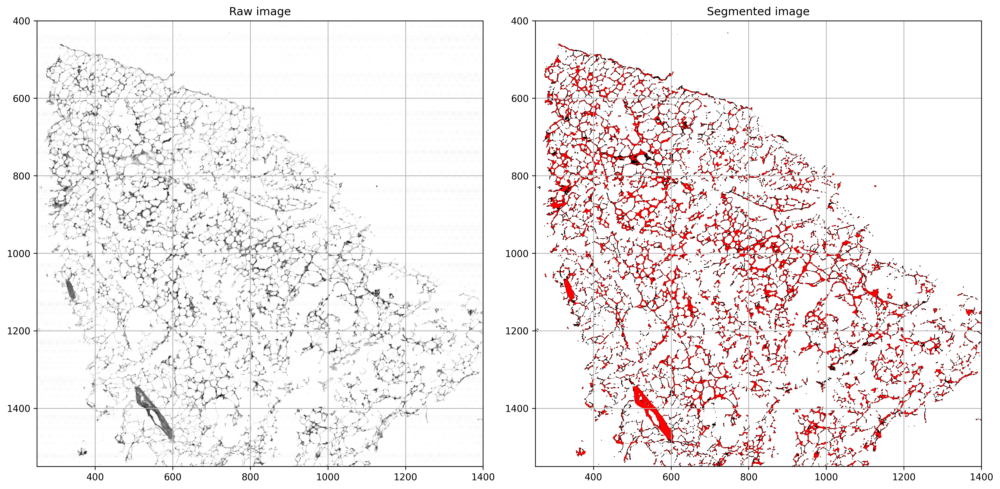

In [52]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import data, segmentation, feature, future
from sklearn.ensemble import RandomForestClassifier
from functools import partial

img = lowres['HFD14']

nClasses = 4
thresholds = skimage.filters.threshold_multiotsu(img, classes=nClasses)
# Using the threshold values, we generate the three regions.
regions = np.digitize(img, bins=thresholds)
training_labels = np.where((regions == 0) | (regions == 1), 1, regions) 
# training_labels = np.where(regions == 4, 

sigma_min = 1
sigma_max = 16
features_func = partial(feature.multiscale_basic_features,
                        intensity=True, edges=False, texture=True,
                        sigma_min=sigma_min, sigma_max=sigma_max) 
                        # channel_axis=-1)

features = features_func(img)
clf = RandomForestClassifier(n_estimators=50, n_jobs=-1,
                             max_depth=10, max_samples=0.05)
clf = future.fit_segmenter(training_labels, features, clf)
result = future.predict_segmenter(features, clf)

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 10

fig, axs = plt.subplots(1, 2)
axs = axs.ravel()

axs[0].imshow(img, cmap='binary_r')
axs[0].grid(True)
axs[0].set_title("Raw image")
axs[0].set_ylim([1550, 400])
axs[0].set_xlim([250, 1400]) 

cmap = mpl.colors.ListedColormap(["r", "k", "w"])

axs[1].imshow(result, cmap=cmap)
axs[1].set_title("Segmented image")
axs[1].grid(True)
axs[1].set_ylim([1550, 400])
axs[1].set_xlim([250, 1400]) 


plt.tight_layout()

Text(0.5, 1.0, 'HFD8')

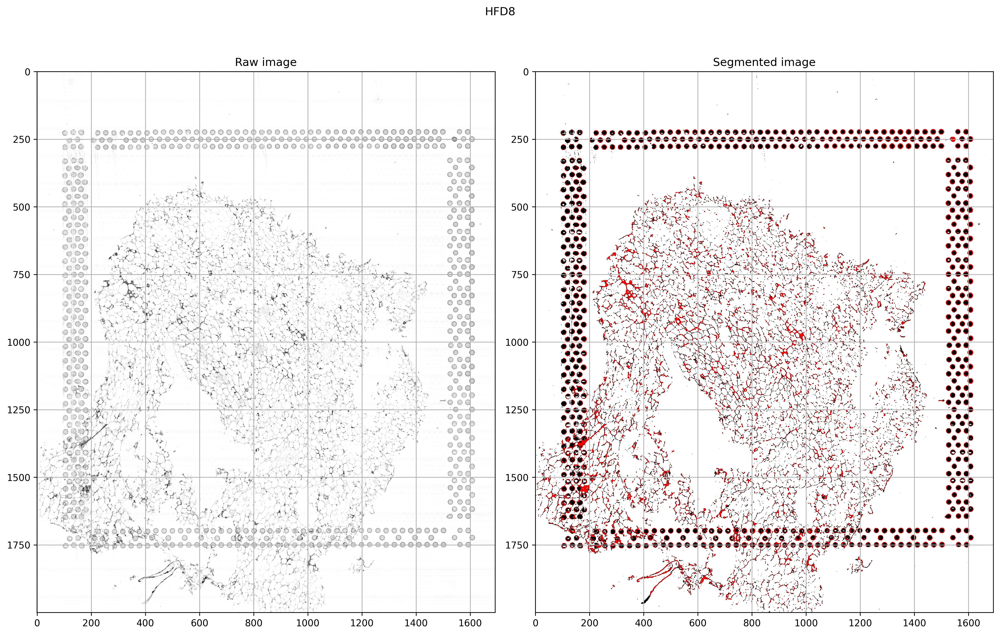

In [60]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.facecolor'] = "w"
plt.rcParams['figure.figsize'] = 15, 10

key = "HFD8"
img_new = lowres[key]

features_new = features_func(img_new)
result_new = future.predict_segmenter(features_new, clf)

fig, axs = plt.subplots(1, 2)
axs = axs.ravel()

axs[0].imshow(img_new, cmap='binary_r')
axs[0].grid(True)
axs[0].set_title("Raw image")

cmap = mpl.colors.ListedColormap(["r", "k", "w"])

axs[1].imshow(result_new, cmap=cmap)
axs[1].set_title("Segmented image")
axs[1].grid(True)

plt.tight_layout()
plt.suptitle(f"{key}",  y=1.0)

In [44]:
# test = img[400:1500, 250:1400]
# nClasses = 4
# thresholds = skimage.filters.threshold_multiotsu(test, classes=nClasses)

# # Using the threshold values, we generate the three regions.
# regions = np.digitize(test, bins=thresholds)

# fig, axs = plt.subplots(1, nClasses)
# axs = axs.ravel()


# for i in range(nClasses):
    
#     labelImg = np.where(regions == i, 1, 0) 
#     axs[i].set_title(f"Label {i}")
#     axs[i].imshow(labelImg, cmap="binary")
#     axs[i].set_xticks([])
#     axs[i].set_yticks([])
    
    
# plt.tight_layout() 

In [45]:
# labelImg = np.where((regions == 0) | (regions == 1), 1, 0) 
# plt.imshow(labelImg, cmap="binary")